In [1]:
import os
import re
import sys

import numpy as np
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn import metrics as skmetrics
from scipy import stats
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.font_manager import fontManager
from IPython.display import display
from ipywidgets import interact, FloatSlider
from umap import UMAP
from sklearn.decomposition import PCA
import ipynbname
from endaaman.ml import fix_global_seed

project_root = os.path.abspath(os.path.join(os.path.dirname(ipynbname.path()), '..'))
if project_root not in sys.path:
    sys.path.insert(0, project_root)
os.chdir(project_root)
print('now working', project_root)

DPI = 300

sns.set_theme(style="ticks", palette="tab10")
# sns.set_theme(style="white")
# plt.rcParams['font.family'] = 'DejaVu Sans'
# plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 10  
plt.rcParams['axes.labelsize'] = 12  
plt.rcParams['axes.titlesize'] = 14  
plt.rcParams['xtick.labelsize'] = 10  
plt.rcParams['ytick.labelsize'] = 10 
plt.rcParams['figure.dpi'] = DPI

os.makedirs('out/figs', exist_ok=True)

fix_global_seed()

now working /home/ken/src/github.com/endaaman/bt


/home/ken/.virtualenvs/ml/lib/python3.12/site-packages/pydantic/_internal/_fields.py:132: UserWarning: Field "model_hash" in BaseTrainerConfig has conflict with protected namespace "model_".

You may be able to resolve this warning by setting `model_config['protected_namespaces'] = ()`.
  warnings.warn(


In [10]:
def inspect(model, target='ebrains', key='correct3'):
    ebs = []
    cvs = []
    for fold in range(5):
        df = pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/{model}/test/report.xlsx', sheet_name='cases')
        df['fold'] = fold
        cvs.append(df)
        ebs.append(pd.read_excel(f'out/compare/LMGAOB/fold5_{fold}/{model}/ebrains.xlsx', sheet_name='cases'))
    
    df_eb = pd.concat(ebs)    
    eb2 = []
    for n, rows in df_eb.groupby('path'):
        eb2.append({
            'name': n,
            'label': rows.iloc[0]['label'],
            'pred': ''.join(rows['pred']),
            'correct': rows['correct'].mean(),
            'correct3': rows['correct3'].mean(),
        })
    df_eb = pd.DataFrame(eb2)

    df_cv = pd.concat(cvs).rename(columns={'diag_org': 'label'})
    df_cv['pred'] = df_cv['pred(sum)']
    
    if target == 'ebrains':
        df = df_eb
    elif target == 'cv':
        df = df_cv
    else:
        raise RuntimeError('Invalid target', target)
    df['title'] = [f'{r["label"]}:{r["pred"]}({r["name"]})' for i,r in df.iterrows()]
    return df[df[key] < 0.5]

def eb2i(df):
    return [Image.open(glob(f'data/EBRAINS/*/{r["name"]}.jpg')[0]) for i, r in df.iterrows()]

def cv2i(names):
    return [Image.open(glob(f'data/EBRAINS/{r["label"]}/{r["name"]}_0.jpg')[0]) for i, r in df.iterrows()]

In [11]:
f_uni = inspect('frozen_uni_500')
u_uni = inspect('unfrozen_uni_500')
f_set = set(f_uni['name'].unique())
u_set = set(u_uni['name'].unique())
common_set = f_set & u_set

eb_common = f_uni[f_uni['name'].isin(common_set)]
eb_only_f = f_uni[f_uni['name'].isin(f_set - common_set)]
eb_only_u = u_uni[u_uni['name'].isin(u_set - common_set)]

print('Common', len(common_set))
display(eb_common)
print('Only frozen', len(f_set))
display(eb_only_f)
print('Only unfrozen', len(u_set))
display(eb_only_u)

Common 21


,name,label,pred,correct,correct3,title
3,a194f78e-357f-11eb-aef1-001a7dda7111,L,GGGGG,0.0,0.0,L:GGGGG(a194f78e-357f-11eb-aef1-001a7dda7111)
6,a194f796-357f-11eb-b46b-001a7dda7111,G,MMMMM,0.0,0.0,G:MMMMM(a194f796-357f-11eb-b46b-001a7dda7111)
29,a1951ee4-357f-11eb-9d0b-001a7dda7111,G,MMMMG,0.2,0.2,G:MMMMG(a1951ee4-357f-11eb-9d0b-001a7dda7111)
31,a1951ef1-357f-11eb-94c7-001a7dda7111,G,MMMMG,0.2,0.2,G:MMMMG(a1951ef1-357f-11eb-94c7-001a7dda7111)
74,a1956cde-357f-11eb-a8bc-001a7dda7111,G,MMMMM,0.0,0.0,G:MMMMM(a1956cde-357f-11eb-a8bc-001a7dda7111)
75,a1956ce4-357f-11eb-9ca6-001a7dda7111,G,GLLLL,0.2,0.2,G:GLLLL(a1956ce4-357f-11eb-9ca6-001a7dda7111)
87,a19593c1-357f-11eb-bb24-001a7dda7111,G,LLLLG,0.2,0.2,G:LLLLG(a19593c1-357f-11eb-bb24-001a7dda7111)
113,a195bb19-357f-11eb-a220-001a7dda7111,O,OLLLL,0.2,0.2,O:OLLLL(a195bb19-357f-11eb-a220-001a7dda7111)
121,a195bb37-357f-11eb-972f-001a7dda7111,G,MMMMM,0.0,0.0,G:MMMMM(a195bb37-357f-11eb-972f-001a7dda7111)
127,a195bb52-357f-11eb-93f8-001a7dda7111,G,MMMMG,0.2,0.2,G:MMMMG(a195bb52-357f-11eb-93f8-001a7dda7111)


Only frozen 25


,name,label,pred,correct,correct3,title
97,a195bac7-357f-11eb-bfc8-001a7dda7111,O,LLLAL,0.0,0.2,O:LLLAL(a195bac7-357f-11eb-bfc8-001a7dda7111)
129,a195e1d3-357f-11eb-86d9-001a7dda7111,A,BABAB,0.4,0.4,A:BABAB(a195e1d3-357f-11eb-86d9-001a7dda7111)
205,a1963044-357f-11eb-b15e-001a7dda7111,O,LLLOL,0.2,0.2,O:LLLOL(a1963044-357f-11eb-b15e-001a7dda7111)
279,a196f396-357f-11eb-92a6-001a7dda7111,A,LLLAL,0.2,0.2,A:LLLAL(a196f396-357f-11eb-92a6-001a7dda7111)


Only unfrozen 38


,name,label,pred,correct,correct3,title
52,a19545d2-357f-11eb-a151-001a7dda7111,A,LGLGL,0.0,0.4,A:LGLGL(a19545d2-357f-11eb-a151-001a7dda7111)
99,a195bacf-357f-11eb-ae3d-001a7dda7111,O,LOLOL,0.4,0.4,O:LOLOL(a195bacf-357f-11eb-ae3d-001a7dda7111)
112,a195bb18-357f-11eb-8a27-001a7dda7111,G,LLLLL,0.0,0.0,G:LLLLL(a195bb18-357f-11eb-8a27-001a7dda7111)
148,a195e20d-357f-11eb-89f6-001a7dda7111,G,MGMGL,0.4,0.4,G:MGMGL(a195e20d-357f-11eb-89f6-001a7dda7111)
155,a195e223-357f-11eb-a41f-001a7dda7111,A,LABBL,0.2,0.2,A:LABBL(a195e223-357f-11eb-a41f-001a7dda7111)
158,a195e233-357f-11eb-9083-001a7dda7111,G,LLGGL,0.4,0.4,G:LLGGL(a195e233-357f-11eb-9083-001a7dda7111)
169,a195e264-357f-11eb-9b07-001a7dda7111,M,LLMLL,0.2,0.2,M:LLMLL(a195e264-357f-11eb-9b07-001a7dda7111)
189,a1960969-357f-11eb-a2ba-001a7dda7111,O,LLLOL,0.2,0.2,O:LLLOL(a1960969-357f-11eb-a2ba-001a7dda7111)
192,a196099c-357f-11eb-abe4-001a7dda7111,O,LALOL,0.2,0.4,O:LALOL(a196099c-357f-11eb-abe4-001a7dda7111)
211,a1963068-357f-11eb-bb42-001a7dda7111,O,OBBOB,0.4,0.4,O:OBBOB(a1963068-357f-11eb-bb42-001a7dda7111)


col 2 row 2
[10, 11]


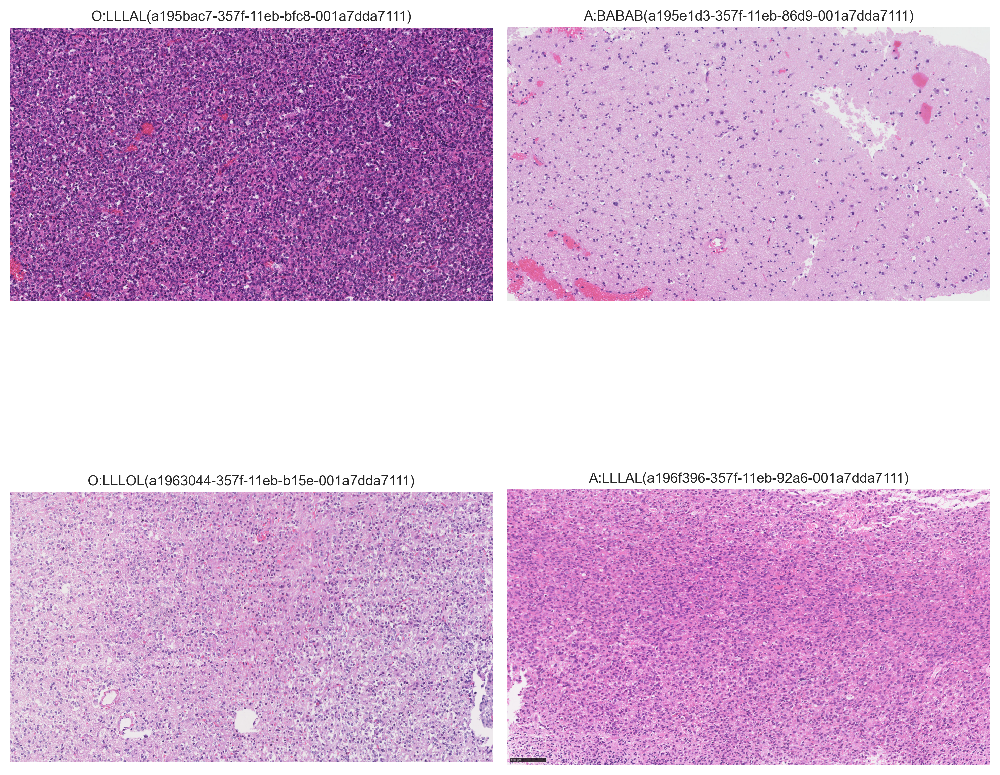

In [13]:
def display_images(images, titles=None, ncols=4, figsize=[10, -1], title_fontsize=10):
    n_images = len(images)
    nrows = int(np.ceil(n_images / ncols))  # 必要な行数を計算

    if titles is not None and len(titles) != n_images:
        raise ValueError('Invalid title count', titles)
    print('col', ncols, 'row', nrows)
    if figsize[1] < 0:
        figsize[1] = int(figsize[0]/(images[0].width*ncols)*(images[0].height*(nrows**2)))
    print(figsize)
    fig = plt.figure(figsize=figsize)

    # 画像とタイトルを配置
    for idx, img in enumerate(images):
        ax = fig.add_subplot(nrows, ncols, idx + 1)
        ax.imshow(img, aspect='equal')
        if titles is not None:
            ax.set_title(titles[idx], fontsize=title_fontsize, pad=5)
        ax.axis('off')  # 軸を非表示
    
    # サブプロット間の余白を調整
    plt.tight_layout()
    # return fig

display_images(
    eb2i(eb_only_f),
    eb_only_f['title'].values,
    ncols=2,
)

col 2 row 9
[10, 11]


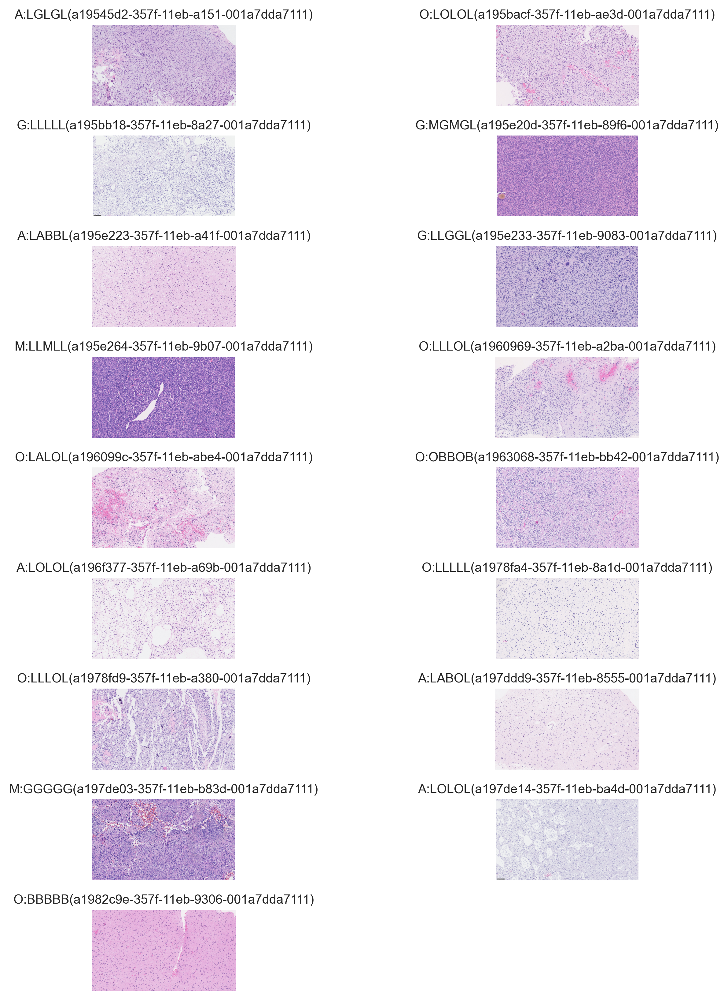

In [14]:
display_images(
    eb2i(eb_only_u),
    eb_only_u['title'].values,
    ncols=2,
)

In [12]:
f_uni = inspect('frozen_uni_500', target='cv')
u_uni = inspect('unfrozen_uni_500', target='cv')
f_set = set(f_uni['name'].unique())
u_set = set(u_uni['name'].unique())
common_set = f_set & u_set

cv_common = f_uni[f_uni['name'].isin(common_set)]
cv_only_f = f_uni[f_uni['name'].isin(f_set - common_set)]
cv_only_u = u_uni[u_uni['name'].isin(u_set - common_set)]

print('Common', len(common_set))
display(cv_common)
print('Only frozen', len(f_set))
display(cv_only_f)
print('Only unfrozen', len(u_set))
display(cv_only_u)

Common 3


,name,label,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold,pred,title
51,N22-263,L,L,G,G,0,0.099502,0,0,0.112532,0.012034,0.346296,0.246341,0.235683,4.711311e-02,3,G,L:G(N22-263)
39,N21-327,G,G,L,L,0,0.395062,0,0,0.566541,0.001254,0.387284,0.038426,0.006495,4.342557e-07,4,L,G:L(N21-327)
69,N20-216,M,M,G,G,0,0.191934,0,0,0.058514,0.225659,0.709200,0.005181,0.001433,1.311676e-05,4,G,M:G(N20-216)


Only frozen 4


,name,label,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold,pred,title
41,22-0107,G,G,M,M,0,0.077213,0,0,0.293542,0.601153,0.103147,0.00087,0.001271,0.000018,1,M,G:M(22-0107)


Only unfrozen 4


,name,label,gt,pred(vote),pred(sum),correct,acc,correct3,correct4,L,M,G,A,O,B,fold,pred,title
66,21-2158,M,M,L,L,0,0.423529,0,0,0.544,0.421595,0.031743,0.00236,0.000213,0.00009,1,L,M:L(21-2158)


col 4 row 1
[10, 11]


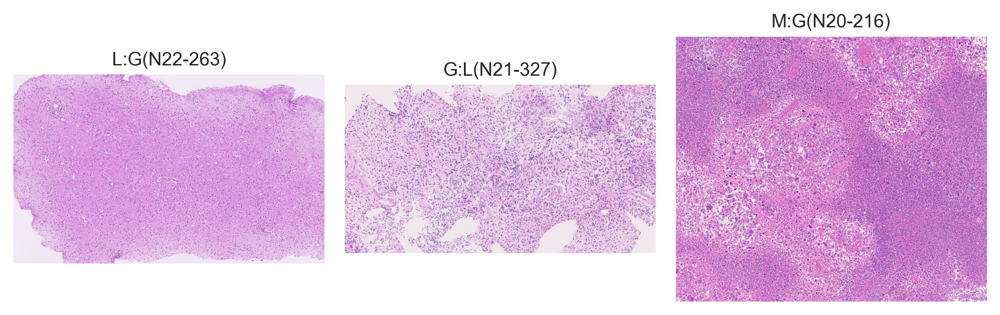

In [7]:
display_images(
    [Image.open(f'data/images/enda4/{r["label"]}/{r["name"]}_01.jpg') for i, r in cv_common.iterrows()],
    cv_common['title'].values
)

col 4 row 1
[10, 11]


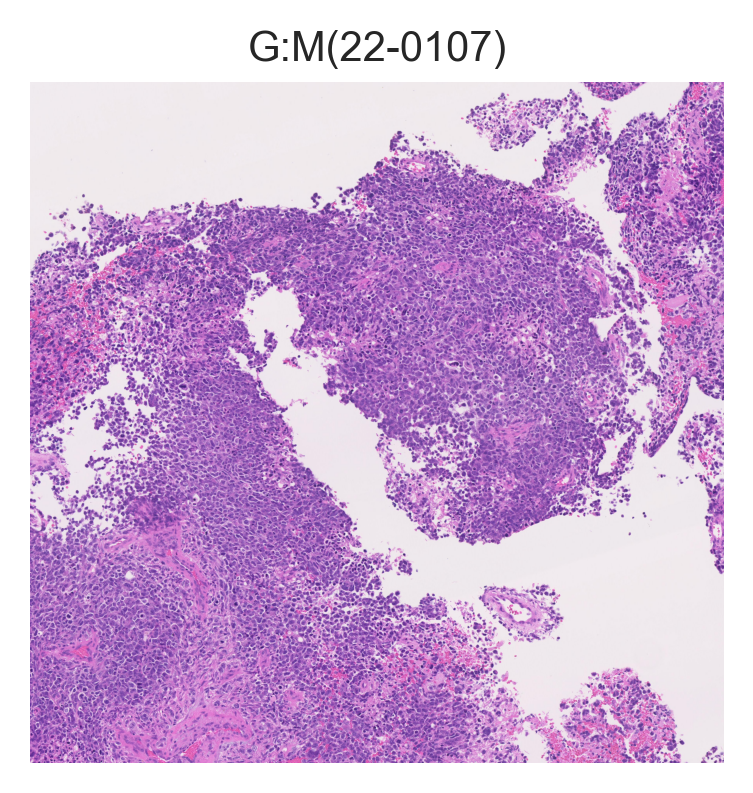

In [8]:
display_images(
    [Image.open(f'data/images/enda4/{r["label"]}/{r["name"]}_01.jpg') for i, r in cv_only_f.iterrows()],
    cv_only_f['title'].values
)

col 4 row 1
[10, 11]


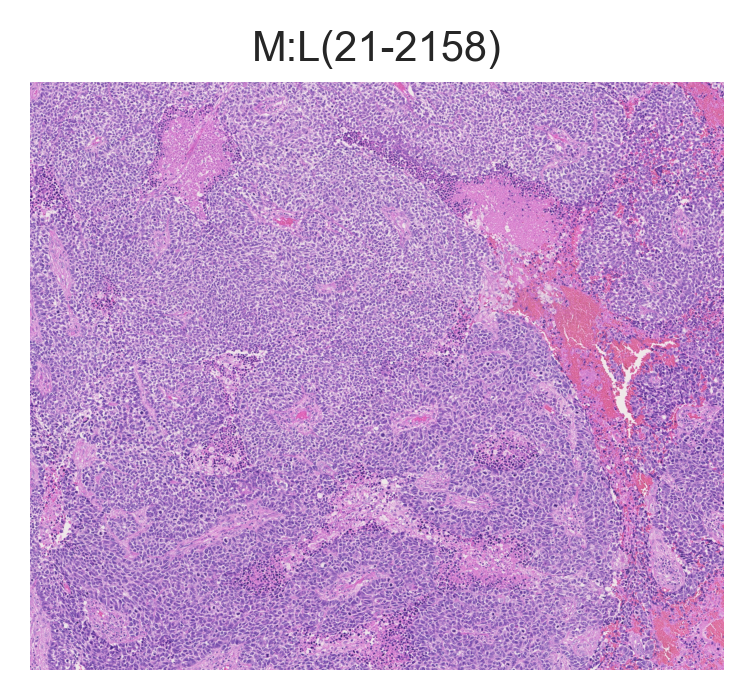

In [9]:
display_images(
    [Image.open(f'data/images/enda4/{r["label"]}/{r["name"]}_01.jpg') for i, r in cv_only_u.iterrows()],
    cv_only_u['title'].values
)